In [76]:
import torch
import torch.nn as nn
import torch.nn.functional as F

In [77]:
### running this will result in an error
class W8A16LinearLayer(nn.Module):
    def __init__(self, in_features, out_features, 
                 bias=True, dtype=torch.float32):
        super().__init__()
        
        self.int8_weights = nn.Parameter(torch.Tensor([0, 1]
                                     ).to(dtype=torch.int8))

try:
    W8A16LinearLayer(1, 1)
except Exception as error:
    print(type(error).__name__, ": ", error)

RuntimeError :  Only Tensors of floating point and complex dtype can require gradients


#### W8A16LinearLayer Module

In [78]:
class W8A16LinearLayer(nn.Module):
    def __init__(self, in_features, out_features, 
                 bias=True, dtype=torch.float32):
        super().__init__()
        
        
        self.register_buffer(
            "int8_weights",
            torch.randint(
                -128, 127, (out_features, in_features), dtype=torch.int8
            )
        )
        
        self.register_buffer("scales", 
                             torch.randn((out_features), dtype=dtype))
        
        if bias:
            self.register_buffer("bias", 
                                 torch.randn((1, out_features), 
                                             dtype=dtype))
        
        else:
            self.bias = None

    def quantize(self, weights):
        w_fp32 = weights.clone().to(torch.float32)

        scales = w_fp32.abs().max(dim=-1).values / 127
        scales = scales.to(weights.dtype)

        int8_weights = torch.round(weights
                        /scales.unsqueeze(1)).to(torch.int8)

        self.int8_weights = int8_weights
        self.scales = scales
    
    def forward(self, input):
        casted_weights = self.int8_weights.to(input.dtype)
        output = F.linear(input, casted_weights) * self.scales
        
        if self.bias is not None:
            output = output + self.bias
        
        return output     

### Testing

In [79]:
module = W8A16LinearLayer(4, 8)

In [80]:
print("Weights before:\n" , module.int8_weights)

Weights before:
 tensor([[-116,  -36,   14,   -2],
        [  53,  -56,   96,   39],
        [  -1,  126,  -99,  114],
        [  98,  -60,  -16, -126],
        [ 104,  -29,   19,   31],
        [  85,  104,  -32,  -46],
        [  -3, -114,  -70,  -12],
        [  -3,  121,  126,   42]], dtype=torch.int8)


In [81]:
random_matrix = torch.randn((4, 8), dtype=torch.bfloat16)

In [82]:
module.quantize(random_matrix)

In [83]:
print("Weights After:\n" , module.int8_weights)

Weights After:
 tensor([[  70,   70, -127,  -53,   25,   32,  -25,   47],
        [ -10,  -14,  -52,   42, -128, -109,   66, -120],
        [ -86,   38,  -63,  -15,  -16,   48, -127, -111],
        [ -34, -128,   72,  -67,  107,   90,   10,  -58]], dtype=torch.int8)


In [84]:
module.scales

tensor([0.0166, 0.0110, 0.0098, 0.0117], dtype=torch.bfloat16)

In [85]:
module.scales.shape

torch.Size([4])

In [86]:
module.int8_weights.shape

torch.Size([4, 8])

In [87]:
### dequantized weights
module.int8_weights * module.scales.unsqueeze(1)

tensor([[ 1.1641,  1.1641, -2.1094, -0.8789,  0.4141,  0.5312, -0.4141,  0.7812],
        [-0.1099, -0.1543, -0.5703,  0.4609, -1.4062, -1.1953,  0.7266, -1.3203],
        [-0.8398,  0.3711, -0.6172, -0.1465, -0.1562,  0.4688, -1.2422, -1.0859],
        [-0.3965, -1.4922,  0.8398, -0.7812,  1.2500,  1.0469,  0.1167, -0.6758]],
       dtype=torch.bfloat16)

In [88]:
### original weights
random_matrix

tensor([[ 1.1719,  1.1641, -2.1094, -0.8789,  0.4141,  0.5234, -0.4160,  0.7812],
        [-0.1128, -0.1484, -0.5742,  0.4648, -1.3984, -1.1953,  0.7227, -1.3125],
        [-0.8398,  0.3672, -0.6172, -0.1426, -0.1562,  0.4648, -1.2422, -1.0859],
        [-0.3906,  1.4844,  0.8477, -0.7812,  1.2500,  1.0547,  0.1182, -0.6797]],
       dtype=torch.bfloat16)

In [89]:
(random_matrix - module.int8_weights 
 * module.scales.unsqueeze(1)).abs().mean()

tensor(0.0957, dtype=torch.bfloat16)

### Quantization Pipeline

In [90]:
def replace_linear_with_target_and_quantize(module, 
                               target_class, module_name_to_exclude):
    for name, child in module.named_children():
        if isinstance(child, nn.Linear) and not \
          any([x == name for x in module_name_to_exclude]):
            old_bias = child.bias
            old_weights = child.weight

            new_module = target_class(child.in_features, 
                                      child.out_features, 
                                      old_bias is not None, 
                                      child.weight.dtype)
            setattr(module, name, new_module)
            getattr(module,name).quantize(old_weights)
            if old_bias is not None:
              getattr(module, name).bias = old_bias
        else:
            # Recursively call the function for nested modules
            replace_linear_with_target_and_quantize(
                child, target_class, module_name_to_exclude)

### Testing Pipeline

In [91]:
class DummyModel(torch.nn.Module):
  def __init__(self):
    super().__init__()
    self.emb = torch.nn.Embedding(1, 1)
    # Try with bias
    self.linear_1 = nn.Linear(1, 1)
    # Try without bias
    self.linear_2 = nn.Linear(1, 1, bias=False)
    # Lm prediction head
    self.lm_head = nn.Linear(1, 1, bias=False)

In [92]:
model_1 = DummyModel()
model_2 = DummyModel()

In [93]:
replace_linear_with_target_and_quantize(model_1, W8A16LinearLayer, ["lm_head"])
print(model_1)

DummyModel(
  (emb): Embedding(1, 1)
  (linear_1): W8A16LinearLayer()
  (linear_2): W8A16LinearLayer()
  (lm_head): Linear(in_features=1, out_features=1, bias=False)
)


In [94]:
replace_linear_with_target_and_quantize(model_2, W8A16LinearLayer, [])
print(model_2)

DummyModel(
  (emb): Embedding(1, 1)
  (linear_1): W8A16LinearLayer()
  (linear_2): W8A16LinearLayer()
  (lm_head): W8A16LinearLayer()
)


### Testing on Open Source Model

#### Language Model

In [95]:
from transformers import AutoModelForCausalLM, AutoTokenizer, pipeline

model_id = "Salesforce/codegen-350M-mono"

model = AutoModelForCausalLM.from_pretrained(model_id, 
                                    torch_dtype=torch.bfloat16, 
                                             low_cpu_mem_usage=True)
tokenizer = AutoTokenizer.from_pretrained(model_id)

Some weights of the model checkpoint at Salesforce/codegen-350M-mono were not used when initializing CodeGenForCausalLM: ['transformer.h.0.attn.causal_mask', 'transformer.h.1.attn.causal_mask', 'transformer.h.10.attn.causal_mask', 'transformer.h.11.attn.causal_mask', 'transformer.h.12.attn.causal_mask', 'transformer.h.13.attn.causal_mask', 'transformer.h.14.attn.causal_mask', 'transformer.h.15.attn.causal_mask', 'transformer.h.16.attn.causal_mask', 'transformer.h.17.attn.causal_mask', 'transformer.h.18.attn.causal_mask', 'transformer.h.19.attn.causal_mask', 'transformer.h.2.attn.causal_mask', 'transformer.h.3.attn.causal_mask', 'transformer.h.4.attn.causal_mask', 'transformer.h.5.attn.causal_mask', 'transformer.h.6.attn.causal_mask', 'transformer.h.7.attn.causal_mask', 'transformer.h.8.attn.causal_mask', 'transformer.h.9.attn.causal_mask']
- This IS expected if you are initializing CodeGenForCausalLM from the checkpoint of a model trained on another task or with another architecture (e

In [96]:
pipe = pipeline("text-generation", model=model, tokenizer=tokenizer)

Device set to use cuda:0


In [97]:
print(pipe("def hello_world():", max_new_tokens=20, do_sample=False))

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


[{'generated_text': 'def hello_world():\n    print("Hello World")\n\nhello_world()\n\n# 파'}]


In [98]:
print("Model before:\n\n", model)

Model before:

 CodeGenForCausalLM(
  (transformer): CodeGenModel(
    (wte): Embedding(51200, 1024)
    (drop): Dropout(p=0.0, inplace=False)
    (h): ModuleList(
      (0-19): 20 x CodeGenBlock(
        (ln_1): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
        (attn): CodeGenAttention(
          (attn_dropout): Dropout(p=0.0, inplace=False)
          (resid_dropout): Dropout(p=0.0, inplace=False)
          (qkv_proj): Linear(in_features=1024, out_features=3072, bias=False)
          (out_proj): Linear(in_features=1024, out_features=1024, bias=False)
        )
        (mlp): CodeGenMLP(
          (fc_in): Linear(in_features=1024, out_features=4096, bias=True)
          (fc_out): Linear(in_features=4096, out_features=1024, bias=True)
          (act): NewGELUActivation()
          (dropout): Dropout(p=0.0, inplace=False)
        )
      )
    )
    (ln_f): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
  )
  (lm_head): Linear(in_features=1024, out_features=51200, bi

In [99]:
replace_linear_with_target_and_quantize(model, 
                                        W8A16LinearLayer, ["lm_head"])

In [100]:
pipe.model

CodeGenForCausalLM(
  (transformer): CodeGenModel(
    (wte): Embedding(51200, 1024)
    (drop): Dropout(p=0.0, inplace=False)
    (h): ModuleList(
      (0-19): 20 x CodeGenBlock(
        (ln_1): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
        (attn): CodeGenAttention(
          (attn_dropout): Dropout(p=0.0, inplace=False)
          (resid_dropout): Dropout(p=0.0, inplace=False)
          (qkv_proj): W8A16LinearLayer()
          (out_proj): W8A16LinearLayer()
        )
        (mlp): CodeGenMLP(
          (fc_in): W8A16LinearLayer()
          (fc_out): W8A16LinearLayer()
          (act): NewGELUActivation()
          (dropout): Dropout(p=0.0, inplace=False)
        )
      )
    )
    (ln_f): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
  )
  (lm_head): Linear(in_features=1024, out_features=51200, bias=True)
)

In [101]:
print(pipe("def hello_world():", max_new_tokens=20, 
           do_sample=False)[0]["generated_text"])

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


def hello_world():
    print("Hello World")

# hello_world()

# def hello_


#### Vision Model

In [102]:
from transformers import DetrImageProcessor, DetrForObjectDetection
from PIL import Image
import matplotlib.pyplot as plt
import requests

# you can specify the revision tag if you don't want the timm dependency
processor = DetrImageProcessor.from_pretrained(
    "facebook/detr-resnet-50", revision="no_timm")
model = DetrForObjectDetection.from_pretrained(
    "facebook/detr-resnet-50", revision="no_timm")

In [103]:
previous_memory_footprint = model.get_memory_footprint()

In [104]:
print("Footprint of the model in MBs: ", 
      previous_memory_footprint/1e+6)

Footprint of the model in MBs:  166.524032


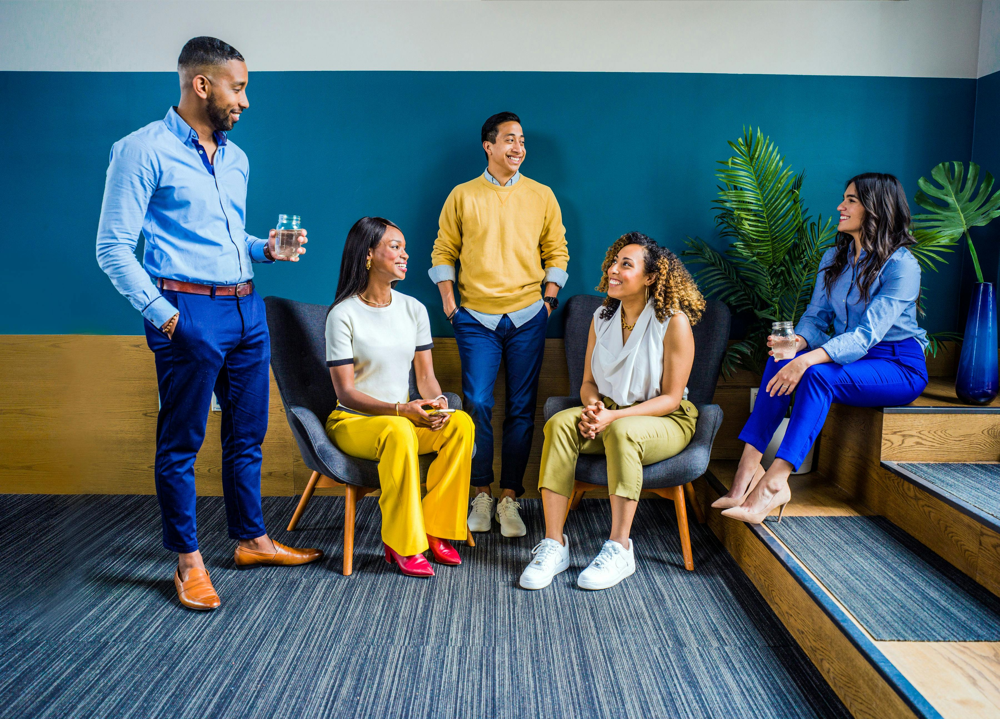

In [105]:
img_path = "test.jpg"
image = Image.open(img_path).convert("RGB")
image

In [106]:
inputs = processor(images=image, return_tensors="pt")
with torch.no_grad():
  outputs = model(**inputs)

# convert outputs (bounding boxes and class logits) to COCO API
# let's only keep detections with score > 0.9
target_sizes = torch.tensor([image.size[::-1]])
results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=0.9)[0]

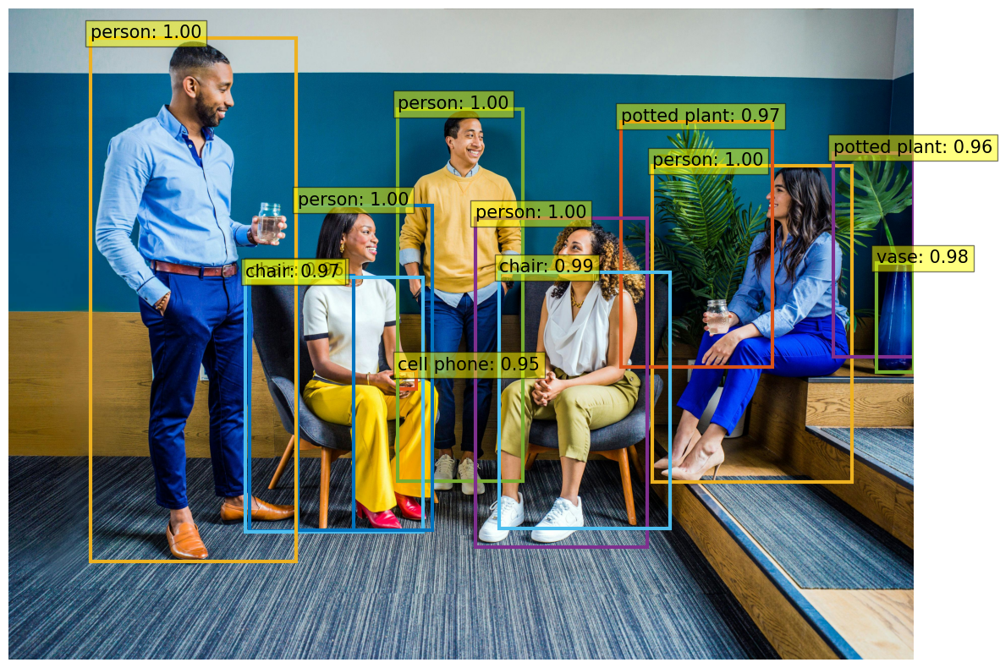

In [107]:
def plot_results(model, pil_img, results):
    
    COLORS = [[0.000, 0.447, 0.741], [0.850, 0.325, 0.098], [0.929, 0.694, 0.125],
          [0.494, 0.184, 0.556], [0.466, 0.674, 0.188], [0.301, 0.745, 0.933]]
    
    plt.figure(figsize=(16,10))
    plt.imshow(pil_img)
    ax = plt.gca()
    scores, labels, boxes = results["scores"], results["labels"], results["boxes"]
    colors = COLORS * 100
    for score, label, (xmin, ymin, xmax, ymax),c  in zip(scores.tolist(), labels.tolist(), boxes.tolist(), colors):
        ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                   fill=False, color=c, linewidth=3))
        text = f'{model.config.id2label[label]}: {score:0.2f}'
        ax.text(xmin, ymin, text, fontsize=15,
                bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.show()
    
plot_results(model, image, results)

In [108]:
model

DetrForObjectDetection(
  (model): DetrModel(
    (backbone): DetrConvModel(
      (conv_encoder): DetrConvEncoder(
        (model): ResNetBackbone(
          (embedder): ResNetEmbeddings(
            (embedder): ResNetConvLayer(
              (convolution): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
              (normalization): DetrFrozenBatchNorm2d()
              (activation): ReLU()
            )
            (pooler): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
          )
          (encoder): ResNetEncoder(
            (stages): ModuleList(
              (0): ResNetStage(
                (layers): Sequential(
                  (0): ResNetBottleNeckLayer(
                    (shortcut): ResNetShortCut(
                      (convolution): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
                      (normalization): DetrFrozenBatchNorm2d()
                    )
                    (layer): Seq

In [109]:
replace_linear_with_target_and_quantize(model, 
                                        W8A16LinearLayer, 
               ["0", "1", "2", "class_labels_classifier"])

In [110]:
inputs = processor(images=image, return_tensors="pt")
with torch.no_grad():
  outputs = model(**inputs)

# convert outputs (bounding boxes and class logits) to COCO API
# let's only keep detections with score > 0.9
target_sizes = torch.tensor([image.size[::-1]])
results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=0.9)[0]

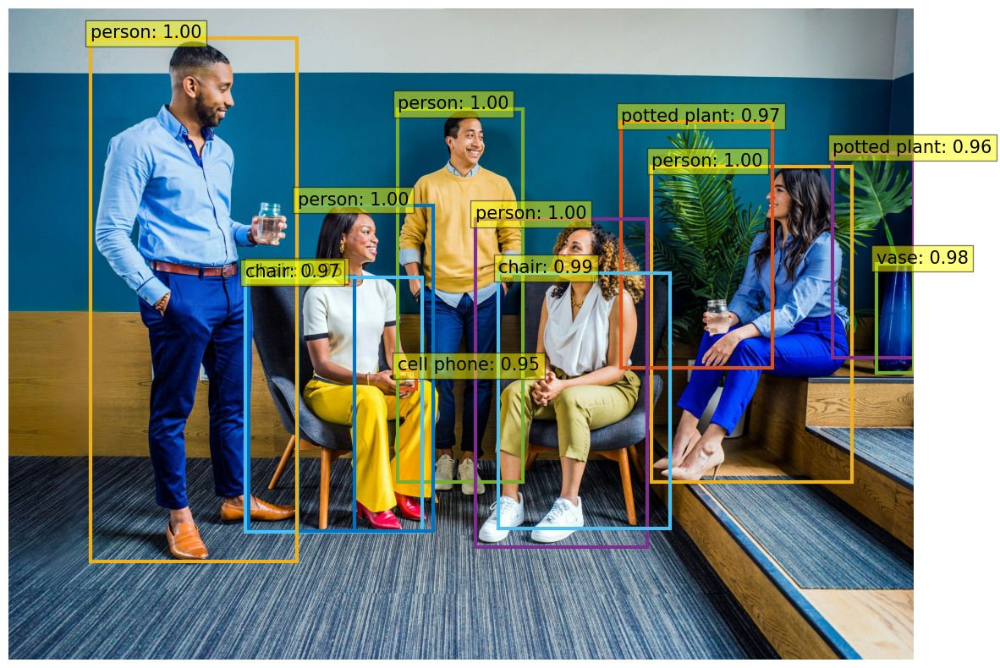

In [111]:
plot_results(model, image, results)

In [112]:
new_footprint = model.get_memory_footprint()

In [113]:
print("Footprint of the model in MBs: ", 
      new_footprint/1e+6)

Footprint of the model in MBs:  114.80384


In [114]:
### Memory saved
print("Memory saved in MBs: ", 
      (previous_memory_footprint - new_footprint)/1e+6)

Memory saved in MBs:  51.720192
